In [5]:
import pandas as pd
import numpy as np
import seaborn as sns

zillow_2016_merged = pd.read_csv('/Users/katherineling/Desktop/Ironhack/zillow_2016_merger.csv') 

zillow_2016_merged.head(100)

,parcelid,logerror,transactiondate,regionidzip,taxdelinquencyflag,airconditioningtypeid,bathroomcnt,bedroomcnt,buildingqualitytypeid,calculatedfinishedsquarefeet,...,regionidcounty,regionidneighborhood,unitcnt,yearbuilt,numberofstories,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount
0,10836049,0.0020,2016-01-08,96415,N,0,1,3,7,1126,...,3101,32368,1,1950,0,22008,61967,2015,39959,933.78
1,10771670,0.0030,2016-01-12,96341,N,0,2,3,7,1216,...,3101,27987,1,1955,0,54031,229427,2015,175396,2838.77
2,10880407,-0.0545,2016-01-05,96450,N,1,1,3,7,984,...,3101,46795,1,1949,0,41803,209018,2015,167215,2655.27
3,10984360,0.0411,2016-01-03,96361,N,0,2,4,7,1150,...,3101,40215,1,1956,0,101800,330000,2015,228200,4205.43
4,12462074,0.0100,2016-01-04,96241,N,0,2,2,7,1648,...,3101,272968,1,1941,0,29551,60330,2015,30779,6542.57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,11655826,-0.2421,2016-01-06,96086,N,1,7,7,10,8520,...,3101,113749,1,1966,0,4969342,7797746,2015,2828404,94997.03
96,12651416,0.0325,2016-01-08,96221,N,0,2,2,4,1876,...,3101,54300,1,1980,0,99970,499867,2015,399897,6106.45
97,10834436,-0.0040,2016-01-08,96415,N,0,1,3,7,1080,...,3101,32368,1,1949,0,19762,61759,2015,41997,801.58
98,10862983,0.0354,2016-01-07,96412,N,1,2,2,4,1261,...,3101,27080,1,1965,0,96788,228845,2015,132057,2867.68


In [6]:
#looked at correlation between x variables with each other to check for multicollinearity
zillow_2016_merged.corr()

,parcelid,logerror,regionidzip,airconditioningtypeid,bathroomcnt,bedroomcnt,buildingqualitytypeid,calculatedfinishedsquarefeet,hashottuborspa,heatingorsystemtypeid,...,regionidcounty,regionidneighborhood,unitcnt,yearbuilt,numberofstories,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount
parcelid,1.000000,-0.011536,-0.490349,-0.291349,-0.170622,-0.156693,0.087599,-0.115816,0.020245,0.214241,...,NaN,0.500169,-0.002439,-0.215242,0.000750,-0.061667,0.011334,NaN,0.045844,0.004438
logerror,-0.011536,1.000000,0.028371,0.018317,0.042362,0.038446,-0.013551,0.045387,0.009145,-0.023552,...,NaN,-0.009757,-0.004504,0.039192,0.001974,0.026176,-0.001330,NaN,-0.014701,-0.021511
regionidzip,-0.490349,0.028371,1.000000,0.286546,0.121099,0.149585,-0.053668,0.038807,0.016186,-0.255370,...,NaN,-0.258431,-0.002968,0.287482,-0.007226,-0.042187,-0.149354,NaN,-0.183409,-0.159928
airconditioningtypeid,-0.291349,0.018317,0.286546,1.000000,0.379628,0.055348,-0.350758,0.206706,0.045923,-0.581132,...,NaN,-0.165391,0.002778,0.596753,-0.005594,0.243385,0.103927,NaN,0.022287,0.074109
bathroomcnt,-0.170622,0.042362,0.121099,0.379628,1.000000,0.594335,-0.307081,0.785632,0.039303,-0.447479,...,NaN,-0.066719,0.010427,0.373463,0.004912,0.607820,0.498116,NaN,0.381795,0.470256
bedroomcnt,-0.156693,0.038446,0.149585,0.055348,0.594335,1.000000,-0.079439,0.686197,0.005405,-0.166644,...,NaN,-0.070958,0.013445,-0.012793,0.006961,0.362034,0.309713,NaN,0.245209,0.304124
buildingqualitytypeid,0.087599,-0.013551,-0.053668,-0.350758,-0.307081,-0.079439,1.000000,-0.191694,-0.043085,0.407112,...,NaN,-0.006770,-0.000225,-0.380733,0.014246,-0.104519,-0.057491,NaN,-0.027151,-0.050090
calculatedfinishedsquarefeet,-0.115816,0.045387,0.038807,0.206706,0.785632,0.686197,-0.191694,1.000000,0.027547,-0.298696,...,NaN,-0.022341,0.005442,0.114306,0.009617,0.693394,0.604731,NaN,0.485425,0.583997
hashottuborspa,0.020245,0.009145,0.016186,0.045923,0.039303,0.005405,-0.043085,0.027547,1.000000,-0.046622,...,NaN,0.021000,-0.001237,0.041821,-0.000698,0.034196,0.023991,NaN,0.015966,0.017493
heatingorsystemtypeid,0.214241,-0.023552,-0.255370,-0.581132,-0.447479,-0.166644,0.407112,-0.298696,-0.046622,1.000000,...,NaN,0.094615,0.003087,-0.540559,-0.003958,-0.261292,-0.172207,NaN,-0.106814,-0.150643


In [7]:
#dropped x variables that displayed high correlation with other x variables

zillow_2016_merged = zillow_2016_merged.drop(columns=['pooltypeid10', 'pooltypeid7', 'bathroomcnt', 'censustractandblock', 'pooltypeid7', 'taxvaluedollarcnt', 'taxamount', 'parcelid'])

##zillow_2016_merged.head(100)

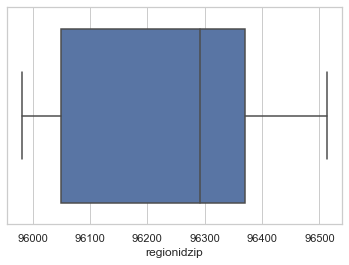

In [8]:
#more exploratory data analysis - checking distributions and outliers


import seaborn as sns
sns.set(style="whitegrid")
tips = sns.load_dataset("tips")

ax = sns.boxplot(x = zillow_2016_merged['regionidzip'])

ax



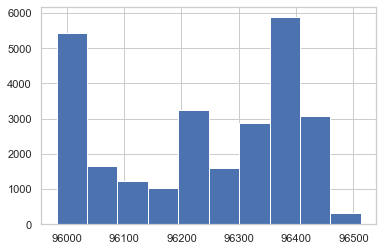

In [9]:
zillow_2016_merged['regionidzip'].hist()

In [14]:
#Checking for outliers using IQR


# value_counts_zip = zillow_2016_merged['regionidzip'].value_counts()

# value_counts_zip

# q1_regionidzip = np.percentile(value_counts_zip, 25)

# q1_regionidzip #remove zipcodes occuring less than 35 times

# q3_regionidzip = np.percentile(value_counts_zip, 75)

# iqr_zip = q3_regionidzip - q1_regionidzip

# #iqr_zip = 176

# upper_fence_zip = q3_regionidzip + (3 * iqr_zip)
# lower_fence_zip = q1_regionidzip  - (3 * iqr_zip)

# upper_fence_zip
# lower_fence_zip

# q1_regionidzip

In [12]:
#eliminating outliers

vc = zillow_2016_merged['regionidzip'].value_counts()
u  = [i not in set(vc[vc<35].index) for i in zillow_2016_merged['regionidzip']]
zillow_2016_merged = zillow_2016_merged[u]

# zillow_2016_merged[zillow_2016_merged['regionidzip'] == 96434]

In [16]:
#zillow_2016_merged['regionidzip'].value_counts()

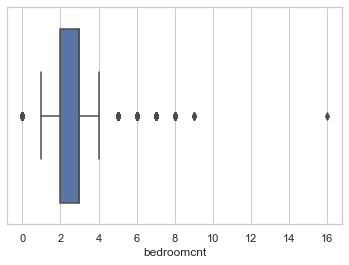

In [17]:
boxplot_bedroomcnt = sns.boxplot(x = zillow_2016_merged['bedroomcnt'])

boxplot_bedroomcnt

In [19]:
# q1_bedroomcnt = np.percentile(zillow_2016_merged.bedroomcnt, 25)

# q1_bedroomcnt 


# q3_bedroomcnt = np.percentile(zillow_2016_merged.bedroomcnt, 75)

# q3_bedroomcnt

In [20]:
iqr_bedroomcnt = q3_bedroomcnt - q1_bedroomcnt

upper_fence_bedroomcnt = q3_bedroomcnt + (3 * iqr_bedroomcnt)

lower_fence_bedroomcnt = q1_bedroomcnt  - (3 * iqr_bedroomcnt)

In [22]:
# upper_fence_bedroomcnt

# lower_fence_bedroomcnt

In [24]:
len(zillow_2016_merged[zillow_2016_merged['bedroomcnt'] > 6])

#drop bedroom counts higher than 6, because these are outliers

72

In [25]:
indexNames = zillow_2016_merged[ zillow_2016_merged['bedroomcnt'] > 6 ].index

zillow_2016_merged.drop(indexNames, inplace=True)

In [26]:
zillow_2016_merged['bedroomcnt'].unique()

array([3, 4, 2, 5, 1, 6, 0])

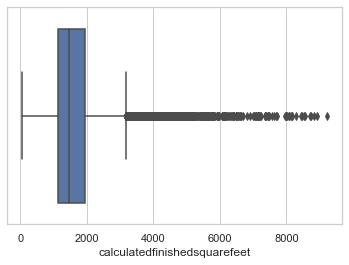

In [27]:
boxplot_calculatedfinishedsquarefeet = sns.boxplot(x = zillow_2016_merged['calculatedfinishedsquarefeet'])

boxplot_calculatedfinishedsquarefeet


In [28]:
# q1_calculatedfinishedsquarefeet = np.percentile(zillow_2016_merged.calculatedfinishedsquarefeet, 25)

# q1_calculatedfinishedsquarefeet


# q3_calculatedfinishedsquarefeet = np.percentile(zillow_2016_merged.calculatedfinishedsquarefeet, 75)

# q3_calculatedfinishedsquarefeet

1944.0

In [30]:
# iqr_calculatedfinishedsquarefeet = q3_calculatedfinishedsquarefeet - q1_calculatedfinishedsquarefeet

# iqr_calculatedfinishedsquarefeet

# upper_fence_calculatedfinishedsquarefeet = q3_calculatedfinishedsquarefeet + (3 * iqr_calculatedfinishedsquarefeet)

# lower_fence_calculatedfinishedsquarefeet = q1_calculatedfinishedsquarefeet  - (3 * iqr_calculatedfinishedsquarefeet)

# upper_fence_calculatedfinishedsquarefeet
# lower_fence_calculatedfinishedsquarefeet

In [31]:
# len(zillow_2016_merged[zillow_2016_merged['calculatedfinishedsquarefeet'] > 4410])

358

In [32]:
indexNames = zillow_2016_merged[ zillow_2016_merged['calculatedfinishedsquarefeet'] > 4410 ].index

zillow_2016_merged.drop(indexNames, inplace=True)

In [35]:
# zillow_2016_merged['calculatedfinishedsquarefeet'].max()

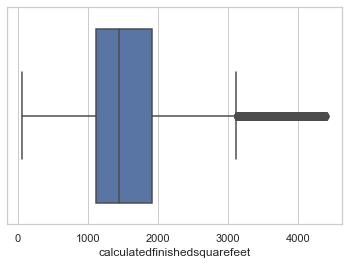

In [34]:
boxplot_calculatedfinishedsquarefeet = sns.boxplot(x = zillow_2016_merged['calculatedfinishedsquarefeet'])

boxplot_calculatedfinishedsquarefeet


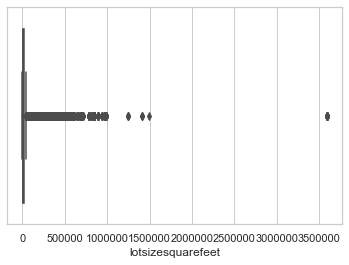

In [36]:
boxplot_lotsizesquarefeet = sns.boxplot(x = zillow_2016_merged['lotsizesquarefeet'])

boxplot_lotsizesquarefeet




In [38]:
# q1_lotsizesquarefeet = np.percentile(zillow_2016_merged.lotsizesquarefeet, 25)


# q3_lotsizesquarefeet = np.percentile(zillow_2016_merged.lotsizesquarefeet, 75)


# iqr_lotsizesquarefeet = q3_lotsizesquarefeet - q1_lotsizesquarefeet

# upper_fence_lotsizesquarefeet = q3_lotsizesquarefeet + (3 * iqr_lotsizesquarefeet)

# lower_fence_lotsizesquarefeet = q1_lotsizesquarefeet  - (3 * iqr_lotsizesquarefeet)


# upper_fence_lotsizesquarefeet

# lower_fence_lotsizesquarefeet

In [39]:
len(zillow_2016_merged[zillow_2016_merged['lotsizesquarefeet'] > 62961])
indexNames = zillow_2016_merged[ zillow_2016_merged['lotsizesquarefeet'] > 62961 ].index

zillow_2016_merged.drop(indexNames, inplace=True)

In [41]:
# zillow_2016_merged['lotsizesquarefeet'].max()


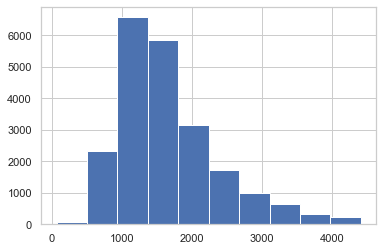

In [42]:
zillow_2016_merged['calculatedfinishedsquarefeet'].hist()

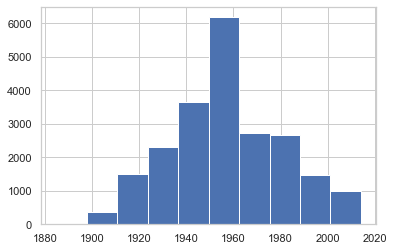

In [43]:
zillow_2016_merged['yearbuilt'].hist()

In [45]:
# zillow_2016_merged = zillow_2016_merged.drop(columns=['numberofstories'])

# zillow_2016_merged

In [47]:
# zillow_2016_merged = zillow_2016_merged.drop(columns=['unitcnt'])

# zillow_2016_merged

In [ ]:
# zillow_2016_merged.head()

In [48]:
#Cleaning categorical variables - replacing "Yes or No" values with numerical 

zillow_2016_merged['taxdelinquencyflag'] = zillow_2016_merged['taxdelinquencyflag'].replace('Y', 1)
zillow_2016_merged['taxdelinquencyflag'] = zillow_2016_merged['taxdelinquencyflag'].replace('N', 0)

In [ ]:
# zillow_2016_merged = zillow_2016_merged.drop(columns=['assessmentyear'])

# zillow_2016_merged

In [49]:
#did one hot encoding to transform categorical variable to numerical

zillow_2016_merged = pd.get_dummies(zillow_2016_merged, columns=["heatingorsystemtypeid"])

zillow_2016_merged

,logerror,transactiondate,regionidzip,taxdelinquencyflag,airconditioningtypeid,bedroomcnt,buildingqualitytypeid,calculatedfinishedsquarefeet,hashottuborspa,latitude,...,regionidcounty,regionidneighborhood,yearbuilt,structuretaxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,heatingorsystemtypeid_2,heatingorsystemtypeid_7,heatingorsystemtypeid_13,heatingorsystemtypeid_20
0,0.0020,2016-01-08,96415,0,0,3,7,1126,0,34187044,...,3101,32368,1950,22008,2015,39959,0,1,0,0
1,0.0030,2016-01-12,96341,0,0,3,7,1216,0,34206714,...,3101,27987,1955,54031,2015,175396,1,0,0,0
2,-0.0545,2016-01-05,96450,0,1,3,7,984,0,34197820,...,3101,46795,1949,41803,2015,167215,1,0,0,0
3,0.0411,2016-01-03,96361,0,0,4,7,1150,0,34280213,...,3101,40215,1956,101800,2015,228200,1,0,0,0
4,0.0100,2016-01-04,96241,0,0,2,7,1648,0,33835857,...,3101,272968,1941,29551,2015,30779,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26375,0.0257,2016-04-15,96221,0,0,2,7,1080,0,33748647,...,3101,54300,1923,117113,2015,266171,0,1,0,0
26376,-0.0010,2016-08-23,96389,0,0,3,4,1518,0,34174946,...,3101,48570,1957,61838,2015,27108,1,0,0,0
26377,0.1240,2016-05-20,96058,0,0,3,10,2740,0,34115800,...,3101,113688,1980,256999,2015,535896,0,0,1,0
26379,0.2585,2016-06-17,96379,1,0,3,4,2162,0,34167465,...,3101,47950,1955,170491,2015,681976,1,0,0,0


In [50]:
indexNames8 = zillow_2016_merged[ zillow_2016_merged['buildingqualitytypeid'] == 8].index

indexNames8


Int64Index([3797], dtype='int64')

In [51]:
zillow_2016_merged.drop(indexNames8, inplace=True)

zillow_2016_merged['buildingqualitytypeid'].value_counts()

7     11405
4      8873
1      1147
10      407
12       22
Name: buildingqualitytypeid, dtype: int64

In [52]:
indexNames12 = zillow_2016_merged[ zillow_2016_merged['buildingqualitytypeid'] == 12].index

zillow_2016_merged.drop(indexNames12, inplace=True)

zillow_2016_merged['buildingqualitytypeid'].value_counts()

7     11405
4      8873
1      1147
10      407
Name: buildingqualitytypeid, dtype: int64

In [53]:
valuecounts = zillow_2016_merged['propertycountylandusecode'].value_counts()

zillow_2016_merged['propertycountylandusecode'].value_counts()

sum(valuecounts)

landusecode_ValueCounts = zillow_2016_merged['propertycountylandusecode'].value_counts()

vc = zillow_2016_merged['propertycountylandusecode'].value_counts()
u  = [i not in set(vc[vc<51].index) for i in zillow_2016_merged['propertycountylandusecode']]
zillow_2016_merged = zillow_2016_merged[u]

In [54]:
zillow_2016_merged['propertycountylandusecode'].value_counts()

0100    13347
0101     3614
010C     2873
010E      929
010D      614
0104      153
012C       94
Name: propertycountylandusecode, dtype: int64

In [55]:
zillow_2016_merged = pd.get_dummies(zillow_2016_merged, columns=["propertycountylandusecode"])

In [56]:
zillow_2016_merged = pd.get_dummies(zillow_2016_merged, columns=["propertylandusetypeid"])

In [60]:
zillow_2016_merged['propertyzoningdesc'].value_counts()

vc = zillow_2016_merged['propertyzoningdesc'].value_counts()
u  = [i not in set(vc[vc<100].index) for i in zillow_2016_merged['propertyzoningdesc']]
zillow_2016_merged = zillow_2016_merged[u]

In [58]:
zillow_2016_merged['propertyzoningdesc'].value_counts()

LAR1       7107
LAR3       1587
LARS       1489
LBR1N      1334
SCUR2       822
LARA        712
LARE11      652
LARD1.5     616
LAR2        613
TORR-LO     574
LARE15      478
PSR6        402
LARD2       328
GLR1YY      321
SCUR1       176
LBR2N       171
LAR4        170
SCSP        160
SCUR3       142
PSR4        138
GLR1*       137
GLR4*       130
LARE9       126
PSR3        120
LARD3       112
PSR1        108
Name: propertyzoningdesc, dtype: int64

In [ ]:
# zillow_2016_merged.head(100)

In [66]:
zillow_2016_merged.shape

(18725, 36)

In [67]:
zillow_2016_merged['transactiondate']

0        20160108
1        20160112
2        20160105
3        20160103
4        20160104
           ...   
26375    20160415
26376    20160823
26377    20160520
26379    20160617
26382    20160704
Name: transactiondate, Length: 18725, dtype: int64

In [69]:
#zillow_2016_merged['transactiondate'] = pd.to_numeric(zillow_2016_merged.transactiondate.str.replace('-',''))

In [70]:
from datetime import datetime


In [72]:
#zillow_2016_merged['transactiondate'].unique()

In [73]:
zillow_2016_merged['transactiondate'].dtype

dtype('int64')

In [74]:
zillow_2016_merged['transactiondate'] = zillow_2016_merged['transactiondate'].astype(str)

In [75]:
zillow_2016_merged['transactiondate'].dtype

dtype('O')

In [76]:
zillow_2016_merged['transactiondate'] = zillow_2016_merged['transactiondate'].str[4:]

In [78]:
#zillow_2016_merged['transactiondate'].unique()


In [79]:
zillow_2016_merged['transactiondate'] = zillow_2016_merged['transactiondate'].str[:2]

In [80]:
zillow_2016_merged['transactiondate'].unique()

array(['01', '08', '06', '07', '09', '10', '03', '02', '12', '04', '05',
       '11'], dtype=object)

In [81]:
zillow_2016_merged['transactiondate'] = zillow_2016_merged['transactiondate'].astype('int')

In [82]:
zillow_2016_merged['transactiondate'].dtype

dtype('int64')

In [84]:
#zillow_2016_merged['transactiondate'].unique()

In [85]:
pd.set_option('display.max_columns', None)

# zillow_2016_merged.head(100)

In [87]:
#zillow_2016_merged['propertyzoningdesc'].unique()

In [88]:
zillow_2016_merged['regionidcity'].unique()

array([12447, 46298, 54311, 54722, 47019, 45457, 33612, 51617, 54299])

In [89]:
zillow_2016_merged['regionidcounty'].unique()

array([3101])

In [91]:
#zillow_2016_merged['regionidneighborhood'].unique()

In [93]:
#zillow_2016_merged['regionidzip'].unique()

In [94]:
#check to see if more x variables can be dropped

zillow_2016_merged.corr()

,logerror,transactiondate,regionidzip,taxdelinquencyflag,airconditioningtypeid,bedroomcnt,buildingqualitytypeid,calculatedfinishedsquarefeet,hashottuborspa,latitude,longitude,lotsizesquarefeet,poolcnt,rawcensustractandblock,regionidcity,regionidcounty,regionidneighborhood,yearbuilt,structuretaxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,heatingorsystemtypeid_2,heatingorsystemtypeid_7,heatingorsystemtypeid_13,heatingorsystemtypeid_20,propertycountylandusecode_0100,propertycountylandusecode_0101,propertycountylandusecode_0104,propertycountylandusecode_010C,propertycountylandusecode_010D,propertycountylandusecode_010E,propertycountylandusecode_012C,propertylandusetypeid_261,propertylandusetypeid_266,propertylandusetypeid_269
logerror,1.000000,0.001056,0.032751,0.012985,0.024963,0.048172,-0.019194,0.055686,0.003252,0.012956,-0.017256,0.013101,-0.008778,-0.000365,0.008442,NaN,-0.012805,0.043501,0.032112,NaN,-0.022848,0.033016,-0.026736,-0.024787,0.002945,0.001009,-0.012825,0.002622,0.013663,-0.007403,0.004793,0.002046,-0.011399,0.014858,-0.007403
transactiondate,0.001056,1.000000,0.020341,0.031990,-0.001315,0.005416,0.004389,-0.003045,-0.008566,0.013064,-0.012096,-0.007299,0.000155,0.013389,0.013352,NaN,-0.004617,0.005993,-0.010024,NaN,-0.011547,0.007260,-0.009423,0.007982,-0.001988,0.000528,0.004638,-0.016715,0.005435,0.013062,-0.019342,-0.011121,0.001614,-0.006758,0.013062
regionidzip,0.032751,0.020341,1.000000,-0.032265,0.273981,0.173895,-0.038455,0.088228,0.017975,0.525897,-0.385343,0.143797,0.234119,0.018461,0.189833,NaN,-0.410342,0.329404,-0.001985,NaN,-0.194101,0.244823,-0.209049,-0.142612,0.012010,-0.182675,0.212500,-0.008219,-0.015845,0.113229,-0.039462,0.043417,-0.017450,-0.025516,0.113229
taxdelinquencyflag,0.012985,0.031990,-0.032265,1.000000,-0.036844,-0.021596,0.033377,-0.029677,-0.002169,-0.023501,0.032224,-0.013379,-0.023693,-0.023110,-0.026088,NaN,0.014155,-0.050039,-0.033852,NaN,-0.023195,-0.047483,0.042419,0.018421,0.012530,0.036567,-0.023763,0.001102,-0.017512,-0.013254,-0.006650,-0.000509,0.022856,-0.018905,-0.013254
airconditioningtypeid,0.024963,-0.001315,0.273981,-0.036844,1.000000,0.121076,-0.420740,0.298377,0.061240,0.358281,-0.276108,0.361181,0.235059,0.069263,0.059063,NaN,-0.198248,0.575964,0.315663,NaN,0.044525,0.597898,-0.575884,-0.102809,-0.005343,-0.430115,0.116417,0.004171,0.370451,0.173510,0.092266,0.083476,-0.434157,0.389439,0.173510
bedroomcnt,0.048172,0.005416,0.173895,-0.021596,0.121076,1.000000,-0.178464,0.664459,-0.003791,0.168619,-0.235185,-0.152935,0.158309,0.064221,0.054799,NaN,-0.093441,0.099436,0.330150,NaN,0.153915,0.250333,-0.235064,-0.066714,0.006889,0.019622,0.299003,0.039743,-0.290579,0.045741,-0.241850,-0.019727,0.344979,-0.380586,0.045741
buildingqualitytypeid,-0.019194,0.004389,-0.038455,0.033377,-0.420740,-0.178464,1.000000,-0.430679,-0.055636,-0.157846,0.237430,-0.270422,-0.226753,0.015024,0.048504,NaN,0.085753,-0.430930,-0.347082,NaN,-0.187692,-0.505329,0.491589,0.070633,-0.005626,0.375842,-0.172534,-0.028355,-0.258670,-0.092752,-0.084098,-0.048129,0.300132,-0.279755,-0.092752
calculatedfinishedsquarefeet,0.055686,-0.003045,0.088228,-0.029677,0.298377,0.664459,-0.430679,1.000000,0.033053,0.148227,-0.238724,0.027847,0.283561,-0.008065,-0.026083,NaN,-0.065800,0.211138,0.631246,NaN,0.377141,0.423593,-0.409363,-0.070769,0.014821,-0.168598,0.378874,0.056774,-0.150753,0.056231,-0.168944,-0.016953,0.188549,-0.220111,0.056231
hashottuborspa,0.003252,-0.008566,0.017975,-0.002169,0.061240,-0.003791,-0.055636,0.033053,1.000000,-0.008653,-0.001037,0.054361,-0.063035,0.022676,0.027208,NaN,0.007944,0.061560,0.050732,NaN,0.014792,0.056458,-0.055638,-0.004783,-0.002410,-0.149272,-0.045666,0.722940,0.071595,0.018131,0.011554,-0.000328,-0.072413,0.069142,0.018131
latitude,0.012956,0.013064,0.525897,-0.023501,0.358281,0.168619,-0.157846,0.148227,-0.008653,1.000000,-0.574658,0.164384,0.186348,-0.037406,-0.039595,NaN,-0.473337,0.326607,0.117104,NaN,-0.082627,0.328756,-0.313401,-0.069451,0.

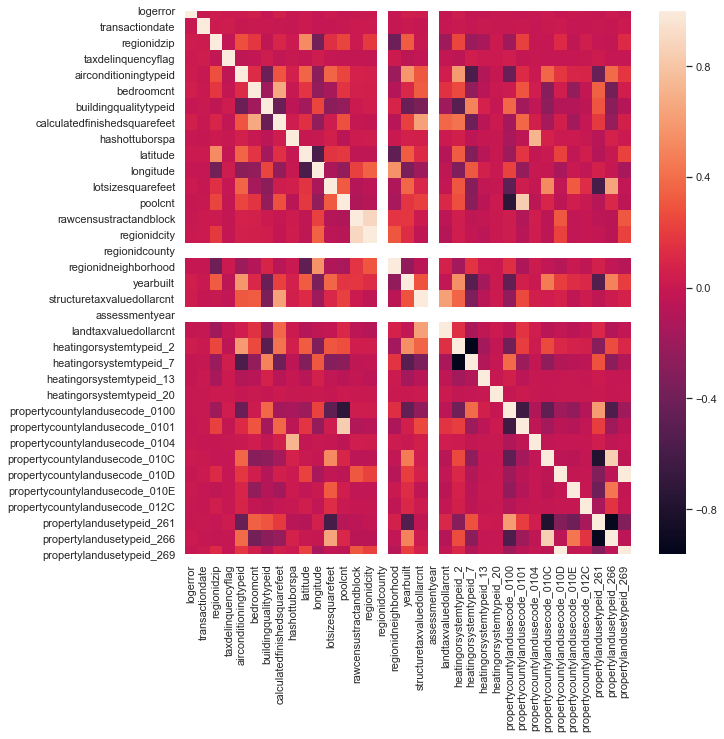

In [95]:
import seaborn as sns
import matplotlib.pyplot as plt

f, ax = plt.subplots(figsize=(10,10))

heatmap = sns.heatmap(zillow_2016_merged.corr())

heatmap

In [96]:
pd.set_option('display.max_rows', None)

# zillow_2016_merged['yearbuilt'] = zillow_2016_merged['yearbuilt'].astype('int')

vc = zillow_2016_merged['yearbuilt'].value_counts()
zillow_2016_merged['yearbuilt'].dtype


#decided to drop homes built before 1935 (Great Depression)

indexNames = zillow_2016_merged[ zillow_2016_merged['yearbuilt'] <1935].index
 
zillow_2016_merged.drop(indexNames , inplace=True)

zillow_2016_merged['yearbuilt'].value_counts()


           

1950    718
1953    630
1954    570
1951    529
1955    515
1947    508
1948    505
1956    504
1952    480
1949    451
1957    346
1964    328
1940    306
1960    306
1959    304
1961    296
1941    291
1965    263
1963    255
1962    254
1981    238
1958    232
1939    229
1979    208
1974    201
1973    201
1988    201
1980    199
1942    197
1938    193
1937    182
1984    170
1989    169
1978    165
1972    165
1946    162
1987    158
1936    158
1985    157
1966    154
1991    150
1944    150
1969    148
1990    141
1968    140
2006    138
1977    129
1982    123
2004    120
2005    115
1986    115
1967    111
1975    110
1976    110
1970    106
1992     96
1983     93
1945     93
1971     92
2001     84
2000     74
2007     74
1943     72
1935     68
1996     63
1995     59
1997     56
2003     55
1998     52
1999     50
2002     47
1994     46
1993     43
2008     24
2009     15
2013     10
2010      8
2012      6
2014      6
2011      5
Name: yearbuilt, dtype: int64

In [ ]:
zillow_2016_merged.head()

In [ ]:
zillow_2016_merged.shape

In [98]:
#zillow_2016_new = zillow_2016_merged.drop(columns=['transactiondate', 'regionidzip', 'propertyzoningdesc', 'rawcensustractandblock', 'latitude', 'longitude', 'regionidcounty', 'regionidneighborhood'])

#zillow_2016_new.head(100)

In [ ]:
zillow_2016_new.shape

In [99]:
zillow_2016_new = pd.get_dummies(zillow_2016_new, columns=["regionidcity"])

In [ ]:
zillow_2016_new.head()

In [ ]:
zillow_2016_new['buildingqualitytypeid'].dtype

In [ ]:
zillow_2016_new[ zillow_2016_new['propertylandusetypeid_269'] == 1 ]

# Scaling Data

In [101]:
from sklearn.preprocessing import MinMaxScaler

import pandas as pd
from sklearn import preprocessing


column_names_to_scale = ['bedroomcnt', 'buildingqualitytypeid', 'calculatedfinishedsquarefeet', 'lotsizesquarefeet', 'poolcnt', 'structuretaxvaluedollarcnt', 'landtaxvaluedollarcnt']

column_names_to_scale


x = zillow_2016_new[column_names_to_scale].values

x

min_max_scaler = preprocessing.MinMaxScaler()

x_scaled = min_max_scaler.fit_transform(x)

x_scaled



a = pd.DataFrame(x_scaled)

a.values

# zillow_2016_new[['bedroomcnt', 'buildingqualitytypeid', 'calculatedfinishedsquarefeet', 'lotsizesquarefeet', 'poolcnt', 'structuretaxvaluedollarcnt', 'landtaxvaluedollarcnt']] = a.values


a.shape











(15295, 7)

In [ ]:
zillow_2016_new.head(100)

In [ ]:
zillow_2016_new.shape

# Transform "year" values into decades

In [102]:
zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype('category')

In [103]:
zillow_2016_new['yearbuilt'].dtype

CategoricalDtype(categories=[1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944,
                  1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954,
                  1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964,
                  1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974,
                  1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984,
                  1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994,
                  1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
                  2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014],
                 ordered=False)

In [104]:
zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype('str')

In [105]:
pd.set_option('display.max_columns', None)

listofyears = list(zillow_2016_new['yearbuilt'].unique())

listofyears

['1950',
 '1955',
 '1949',
 '1956',
 '1941',
 '1935',
 '1947',
 '1987',
 '1952',
 '1973',
 '1940',
 '1989',
 '1978',
 '1988',
 '1953',
 '1936',
 '1961',
 '1942',
 '1970',
 '1960',
 '1995',
 '1951',
 '1971',
 '1999',
 '1966',
 '2000',
 '1985',
 '1982',
 '1946',
 '1981',
 '1957',
 '1980',
 '1963',
 '2003',
 '1948',
 '1965',
 '1974',
 '1964',
 '1938',
 '1968',
 '2004',
 '1954',
 '1986',
 '1939',
 '1972',
 '1958',
 '1983',
 '1984',
 '1997',
 '1959',
 '1962',
 '1990',
 '1937',
 '1967',
 '2006',
 '2001',
 '1979',
 '1992',
 '1991',
 '2005',
 '1993',
 '2009',
 '1996',
 '2012',
 '1969',
 '1944',
 '1976',
 '1943',
 '1975',
 '2013',
 '1977',
 '1994',
 '1945',
 '1998',
 '2007',
 '2008',
 '2002',
 '2011',
 '2010',
 '2014']

In [106]:
zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype('int')

In [107]:
indexNames = zillow_2016_new[ zillow_2016_new['yearbuilt'] <1935].index
 
zillow_2016_new.drop(indexNames , inplace=True)

zillow_2016_new['yearbuilt'].value_counts()


1950    718
1953    630
1954    570
1951    529
1955    515
1947    508
1948    505
1956    504
1952    480
1949    451
1957    346
1964    328
1940    306
1960    306
1959    304
1961    296
1941    291
1965    263
1963    255
1962    254
1981    238
1958    232
1939    229
1979    208
1974    201
1973    201
1988    201
1980    199
1942    197
1938    193
1937    182
1984    170
1989    169
1978    165
1972    165
1946    162
1987    158
1936    158
1985    157
1966    154
1991    150
1944    150
1969    148
1990    141
1968    140
2006    138
1977    129
1982    123
2004    120
2005    115
1986    115
1967    111
1975    110
1976    110
1970    106
1992     96
1983     93
1945     93
1971     92
2001     84
2000     74
2007     74
1943     72
1935     68
1996     63
1995     59
1997     56
2003     55
1998     52
1999     50
2002     47
1994     46
1993     43
2008     24
2009     15
2013     10
2010      8
2012      6
2014      6
2011      5
Name: yearbuilt, dtype: int64

In [201]:
#zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype('str')

In [109]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'195':'1950'}, regex=True))


In [111]:
#zillow_2016_new['yearbuilt'].unique()

In [112]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'193':'1930'}, regex=True))

In [113]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'194':'1940'}, regex=True))

In [114]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'196':'1960'}, regex=True))

In [115]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'197':'1970'}, regex=True))

In [116]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'198':'1980'}, regex=True))

In [117]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'199':'1990'}, regex=True))

In [118]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'20':'2000'}, regex=True))

In [119]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'201':'2010'}, regex=True))

In [121]:
#zillow_2016_new['yearbuilt'].unique()

In [122]:
zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype(str).str[:-1]

In [124]:
#zillow_2016_new['yearbuilt']

In [125]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'19500':'1950'}, regex=True))

In [126]:
#zillow_2016_new['yearbuilt'].unique()

In [127]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'20000':'2000'}, regex=True))

In [128]:
zillow_2016_new['yearbuilt'] = (zillow_2016_new.yearbuilt.replace({'20001':'2010'}, regex=True))

In [130]:
#zillow_2016_new['yearbuilt'].unique()

In [131]:
zillow_2016_new['yearbuilt'] = zillow_2016_new['yearbuilt'].astype('category')

In [134]:
# zillow_2016_new = pd.get_dummies(zillow_2016_new, columns=["yearbuilt"])

# #zillow_2016_new.head(100)

In [135]:
zillow_2016_new.shape

(15295, 44)

In [137]:
#zillow_2016_new.columns

# Train Test Split 

In [138]:
x = zillow_2016_new[zillow_2016_new.columns].drop(columns = ["logerror"])

x

y =zillow_2016_new["logerror"]

y

0        0.0020
1        0.0030
2       -0.0545
3        0.0411
4        0.0100
7        0.0469
8       -0.0263
9       -0.0111
11       0.0208
15      -0.0171
17      -0.1165
18       0.0198
19       0.0266
20       0.0257
22       0.0807
23       0.1026
27      -0.0070
31      -0.0899
32      -0.0020
33       0.0119
34       0.0554
35       0.0257
38      -0.0151
39      -0.0440
42       0.1493
44      -0.2614
45       0.0266
48       0.0770
49       0.0325
51      -0.1485
52      -0.0161
54      -0.7941
57       0.0080
58       0.0843
59       0.0030
63       0.0198
64       0.0100
66       0.0208
67      -0.0141
68      -0.0030
69       0.0315
71      -0.0060
72      -0.0419
74       0.0090
76      -0.0747
78       0.0040
79       0.0797
80      -0.0704
82      -0.0212
84       0.0686
86      -0.0398
87       0.1432
89      -0.0010
91       0.0060
92       0.0010
94       0.0286
96       0.0325
97      -0.0040
98       0.0354
99       0.0060
100      0.2859
102     -0.0253
103     

In [139]:
from sklearn.model_selection import train_test_split

#split the data into 80% training data and 20% testing data

x_train, x_test, y_train, y_test = train_test_split(x,y,train_size = .8)

In [140]:
x_train.shape

(12236, 43)

# Principal Component Analysis

In [141]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

#did PCA on numerical variables to see if amount of variables could be refined even further...


pca_zillow = PCA(n_components=7)


principalComponents_zillow = pca_zillow.fit_transform(a)

principalComponents_zillow


array([[-0.30550608, -0.15321972, -0.07718371, ..., -0.06701794,
        -0.01940182, -0.00175444],
       [-0.29999499, -0.14017287, -0.07307425, ..., -0.04887736,
        -0.0039608 , -0.00895605],
       [-0.30862426, -0.16866084, -0.06632336, ..., -0.08231744,
         0.00919447, -0.0063878 ],
       ...,
       [-0.19457929, -0.20333742,  0.11681958, ...,  0.17554017,
        -0.02337454, -0.03926639],
       [ 0.76450194,  0.03921128,  0.0533663 , ...,  0.03367863,
         0.0131306 , -0.05124394],
       [-0.31301575, -0.20797421,  0.00707736, ...,  0.0610345 ,
        -0.02584322, -0.011019  ]])

In [ ]:
pca_zillow

In [142]:
pca = PCA()
pca.fit(a)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [143]:
variations = pca.explained_variance_ratio_*100
variations = np.round(variations, decimals=1)
variations

array([63.5, 16. , 11.6,  5.5,  2.5,  0.7,  0.3])

In [144]:
plot_labels = ['PC'+str(i) for i in range(1,len(variations)+1)]
?plot_labels

Text(0.5, 1.0, 'PCA Scree Plot')

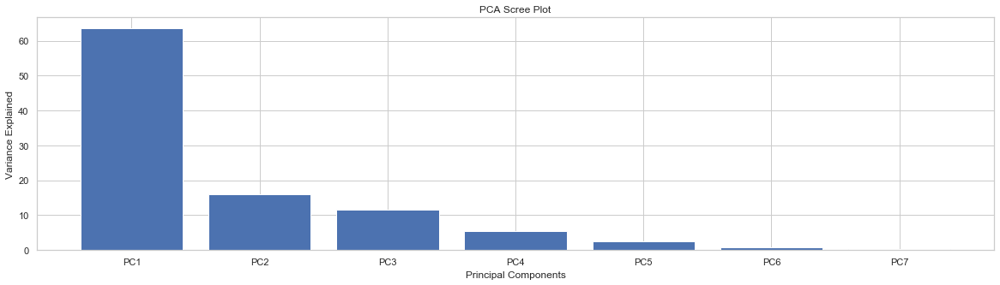

In [145]:
from matplotlib.pyplot import figure
figure(figsize=(20,5))
plt.bar(x = plot_labels, height=variations)
plt.xlabel('Principal Components')
plt.ylabel('Variance Explained')
plt.title('PCA Scree Plot')

In [ ]:
zillow_2016_new.columns



In [146]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x_scaled)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2', 'principal component 3'])

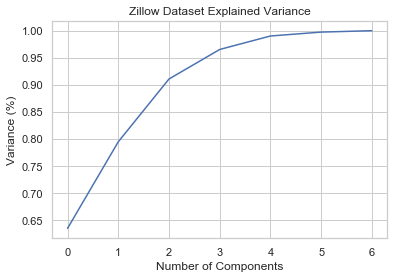

In [147]:
pca = PCA().fit(principalComponents_zillow)
#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Zillow Dataset Explained Variance')
plt.show()

In [ ]:
principalComponents_zillow

In [148]:
principal_zillow_Df = pd.DataFrame(data = principalComponents_zillow, columns = ['PC 1', 'PC 2', 'PC 3', 'PC 4', 'PC 5', 'PC 6', 'PC 7'])

principal_zillow_Df

                      
                         
                         
                         
                         

,PC 1,PC 2,PC 3,PC 4,PC 5,PC 6,PC 7
0,-0.305506,-0.153220,-7.718371e-02,-0.012062,-0.067018,-0.019402,-0.001754
1,-0.299995,-0.140173,-7.307425e-02,0.011430,-0.048877,-0.003961,-0.008956
2,-0.308624,-0.168661,-6.632336e-02,-0.019592,-0.082317,0.009194,-0.006388
3,-0.291206,-0.081237,-1.573688e-01,0.057986,-0.165472,0.039407,0.000195
4,-0.302542,-0.153419,-3.265915e-02,-0.032586,0.123471,-0.079201,-0.009134
5,-0.243395,0.141344,1.024177e-01,-0.064032,-0.053680,-0.004827,0.002055
6,-0.281277,-0.062011,-1.125147e-01,0.065376,0.047768,-0.025866,0.012422
7,-0.307045,-0.163373,-6.808998e-02,-0.013483,-0.079847,-0.015226,0.004588
8,-0.304420,-0.150189,-7.662609e-02,-0.008221,-0.059386,0.003808,-0.004857
9,0.794146,0.125256,1.708515e-02,0.125444,-0.064917,0.002977,0.033984


In [ ]:
principal_zillow_Df.tail()

In [149]:
print('Explained variation per principal component: {}'.format(pca_zillow.explained_variance_ratio_))

Explained variation per principal component: [0.63517387 0.1597659  0.11593095 0.05450242 0.02484964 0.00721083
 0.00256639]


In [150]:
pca_new = PCA(n_components=4)

pca_new
# zillow_dataset = pca_new.fit_transform(x_scaled)

PCA(copy=True, iterated_power='auto', n_components=4, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [151]:
#picked the top 4 principal components, as the top 4 explain over 95% of the variation in y

top_pca = principal_zillow_Df.iloc[:, : 4]

In [152]:
top_pca

,PC 1,PC 2,PC 3,PC 4
0,-0.305506,-0.153220,-7.718371e-02,-0.012062
1,-0.299995,-0.140173,-7.307425e-02,0.011430
2,-0.308624,-0.168661,-6.632336e-02,-0.019592
3,-0.291206,-0.081237,-1.573688e-01,0.057986
4,-0.302542,-0.153419,-3.265915e-02,-0.032586
5,-0.243395,0.141344,1.024177e-01,-0.064032
6,-0.281277,-0.062011,-1.125147e-01,0.065376
7,-0.307045,-0.163373,-6.808998e-02,-0.013483
8,-0.304420,-0.150189,-7.662609e-02,-0.008221
9,0.794146,0.125256,1.708515e-02,0.125444


In [ ]:
#concatenate with categorical variables

In [ ]:
taxdelinquencyflag
airconditioningtypeid
hashottuborspa
regionidcity_45457
regionidcity_46298
regionidcity_47019
regionidcity_48424
regionidcity_51617
regionidcity_51861
regionidcity_54299
regionidcity_54311
regionidcity_54722
regionidcity_396054
yearbuilt_1930
yearbuilt_1940
yearbuilt_1950
yearbuilt_1960
yearbuilt_1970
yearbuilt_1980
yearbuilt_1990
yearbuilt_2000
yearbuilt_2010

In [154]:
categorical_columns = ['taxdelinquencyflag', 'airconditioningtypeid', 'hashottuborspa', 'regionidcity_45457',
                      'regionidcity_46298', 'regionidcity_47019', 'regionidcity_51617',
                      'regionidcity_54299', 'regionidcity_54311', 'regionidcity_54722',
                       'yearbuilt_1930', 'yearbuilt_1940', 'yearbuilt_1950', 'yearbuilt_1960',
                      'yearbuilt_1970', 'yearbuilt_1980', 'yearbuilt_1990', 'yearbuilt_2000', 'yearbuilt_2010']

In [155]:

categorical = zillow_2016_new[categorical_columns].values

categorical

categorical_df = pd.DataFrame(categorical, columns = ['taxdelinquencyflag', 'airconditioningtypeid', 'hashottuborspa', 'regionidcity_45457',
                      'regionidcity_46298', 'regionidcity_47019', 'regionidcity_51617',
                      'regionidcity_54299', 'regionidcity_54311', 'regionidcity_54722',
                       'yearbuilt_1930', 'yearbuilt_1940', 'yearbuilt_1950', 'yearbuilt_1960',
                      'yearbuilt_1970', 'yearbuilt_1980', 'yearbuilt_1990', 'yearbuilt_2000', 'yearbuilt_2010'])

categorical_df



,taxdelinquencyflag,airconditioningtypeid,hashottuborspa,regionidcity_45457,regionidcity_46298,regionidcity_47019,regionidcity_51617,regionidcity_54299,regionidcity_54311,regionidcity_54722,yearbuilt_1930,yearbuilt_1940,yearbuilt_1950,yearbuilt_1960,yearbuilt_1970,yearbuilt_1980,yearbuilt_1990,yearbuilt_2000,yearbuilt_2010
0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
8,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
9,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0


In [156]:
top_pca.shape

(15295, 4)

In [157]:
categorical_df.shape

(15295, 19)

In [158]:


concatenated_result2 = pd.concat([categorical_df, top_pca], axis=1)

concatenated_result2.shape

(15295, 23)

In [159]:
concatenated_result2.head()

,taxdelinquencyflag,airconditioningtypeid,hashottuborspa,regionidcity_45457,regionidcity_46298,regionidcity_47019,regionidcity_51617,regionidcity_54299,regionidcity_54311,regionidcity_54722,yearbuilt_1930,yearbuilt_1940,yearbuilt_1950,yearbuilt_1960,yearbuilt_1970,yearbuilt_1980,yearbuilt_1990,yearbuilt_2000,yearbuilt_2010,PC 1,PC 2,PC 3,PC 4
0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.305506,-0.153220,-0.077184,-0.012062
1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.299995,-0.140173,-0.073074,0.011430
2,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.308624,-0.168661,-0.066323,-0.019592
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.291206,-0.081237,-0.157369,0.057986
4,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.302542,-0.153419,-0.032659,-0.032586


In [161]:
concatenated_result2 = pd.concat([categorical_df, top_pca], axis=1)

In [160]:
y = zillow_2016_new['logerror'].values



y_df = pd.DataFrame(y, columns = ['logerror'])

y_df

,logerror
0,0.0020
1,0.0030
2,-0.0545
3,0.0411
4,0.0100
5,0.0469
6,-0.0263
7,-0.0111
8,0.0208
9,-0.0171


In [162]:
concatenated_result2 = pd.concat([categorical_df, top_pca], axis=1)

In [163]:
concat_x_y = pd.concat([y_df, concatenated_result2], axis=1)
pd.set_option('display.max_columns', None)
concat_x_y.head()

,logerror,taxdelinquencyflag,airconditioningtypeid,hashottuborspa,regionidcity_45457,regionidcity_46298,regionidcity_47019,regionidcity_51617,regionidcity_54299,regionidcity_54311,regionidcity_54722,yearbuilt_1930,yearbuilt_1940,yearbuilt_1950,yearbuilt_1960,yearbuilt_1970,yearbuilt_1980,yearbuilt_1990,yearbuilt_2000,yearbuilt_2010,PC 1,PC 2,PC 3,PC 4
0,0.0020,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.305506,-0.153220,-0.077184,-0.012062
1,0.0030,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.299995,-0.140173,-0.073074,0.011430
2,-0.0545,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.308624,-0.168661,-0.066323,-0.019592
3,0.0411,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,-0.291206,-0.081237,-0.157369,0.057986
4,0.0100,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.302542,-0.153419,-0.032659,-0.032586


In [164]:
concat_x_y.shape

(15295, 24)

# Linear Regression

In [165]:
from sklearn import linear_model
from sklearn import metrics
from sklearn.linear_model import LinearRegression


In [166]:
linearregression_model = linear_model.LinearRegression()

In [167]:
regressor = LinearRegression()  
regressor.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [168]:
coeff_df = pd.DataFrame(regressor.coef_, x.columns, columns=['Coefficient'])  
coeff_df

,Coefficient
taxdelinquencyflag,1.227068e-02
airconditioningtypeid,3.112918e-03
bedroomcnt,1.369172e-03
buildingqualitytypeid,1.719867e-03
calculatedfinishedsquarefeet,1.348768e-05
hashottuborspa,-1.616227e-02
lotsizesquarefeet,-1.894788e-07
poolcnt,-2.083502e-03
structuretaxvaluedollarcnt,9.785535e-08
assessmentyear,-3.188318e-13


In [169]:
y_pred = regressor.predict(x_test)

y_pred

array([0.01153783, 0.01272423, 0.02268194, ..., 0.02577772, 0.01396944,
       0.02396644])

In [170]:
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df1 = df.head(25)

In [ ]:
df1

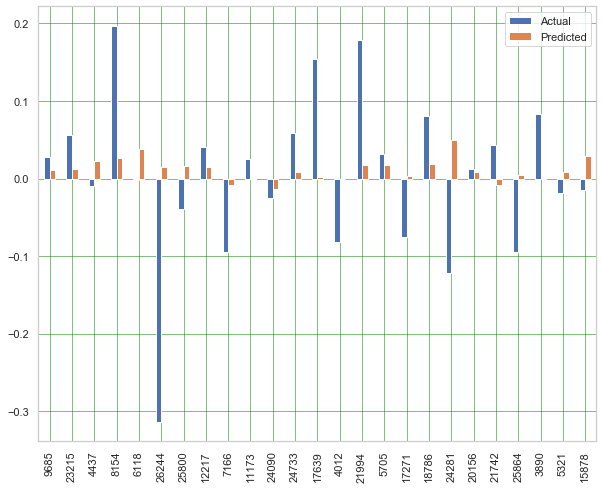

In [171]:
df1.plot(kind='bar',figsize=(10,8))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.show()

In [172]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 0.07249409176028965
Mean Squared Error: 0.026328754535058688
Root Mean Squared Error: 0.16226137721299758


In [173]:
regressor.score(x_test, y_test)

0.015144468958758874

In [174]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
data = pd.concat([x_train,y_train], axis=1)
model = ols("y_train~x_train", data=data).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                y_train   R-squared:                       0.019
Model:                            OLS   Adj. R-squared:                  0.016
Method:                 Least Squares   F-statistic:                     6.598
Date:                Mon, 10 Feb 2020   Prob (F-statistic):           2.31e-30
Time:                        21:01:35   Log-Likelihood:                 5121.8
No. Observations:               12236   AIC:                        -1.017e+04
Df Residuals:                   12200   BIC:                            -9905.
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept   -9.658e-09   7.22e-09     -1.338      

In [ ]:
#x_train

In [176]:
%matplotlib inline
#visualizer.poof() 

In [177]:
!pip install patsy
!pip install statsmodels

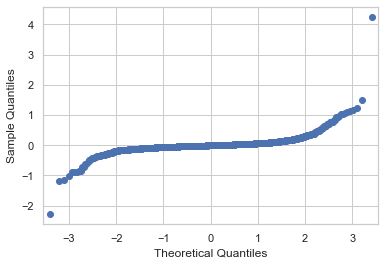

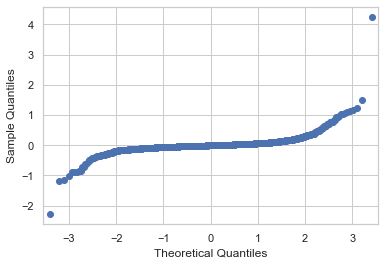

In [178]:
import statsmodels.api as sm

linearregression_model = linear_model.LinearRegression()

linearregression_model.fit(x_train, y_train)

predictions = linearregression_model.predict(x_test)
residuals = y_test - predictions
sm.qqplot(residuals)



In [179]:
predictions

array([0.01153783, 0.01272423, 0.02268194, ..., 0.02577772, 0.01396944,
       0.02396644])

# Random Forest

In [180]:
X = zillow_2016_new[zillow_2016_new.columns].drop(columns = ["logerror"])

X

y =zillow_2016_new["logerror"]

y

0        0.0020
1        0.0030
2       -0.0545
3        0.0411
4        0.0100
7        0.0469
8       -0.0263
9       -0.0111
11       0.0208
15      -0.0171
17      -0.1165
18       0.0198
19       0.0266
20       0.0257
22       0.0807
23       0.1026
27      -0.0070
31      -0.0899
32      -0.0020
33       0.0119
34       0.0554
35       0.0257
38      -0.0151
39      -0.0440
42       0.1493
44      -0.2614
45       0.0266
48       0.0770
49       0.0325
51      -0.1485
52      -0.0161
54      -0.7941
57       0.0080
58       0.0843
59       0.0030
63       0.0198
64       0.0100
66       0.0208
67      -0.0141
68      -0.0030
69       0.0315
71      -0.0060
72      -0.0419
74       0.0090
76      -0.0747
78       0.0040
79       0.0797
80      -0.0704
82      -0.0212
84       0.0686
86      -0.0398
87       0.1432
89      -0.0010
91       0.0060
92       0.0010
94       0.0286
96       0.0325
97      -0.0040
98       0.0354
99       0.0060
100      0.2859
102     -0.0253
103     

In [181]:
from sklearn.model_selection import train_test_split




x_train, x_test, y_train,y_test = train_test_split(x,y,train_size = .8)

In [182]:
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score


In [183]:
# Instantiate model with 100 decision trees
rf = RandomForestRegressor(n_estimators = 100, oob_score = True, random_state = 0)
# Train the model on training data
rf.fit(x_train, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=True, random_state=0, verbose=0,
                      warm_start=False)

In [184]:
from sklearn.metrics import r2_score
from scipy.stats import spearmanr, pearsonr
predicted_train = rf.predict(x_train)
predicted_test = rf.predict(x_test)
test_score = r2_score(y_test, predicted_test)
spearman = spearmanr(y_test, predicted_test)
pearson = pearsonr(y_test, predicted_test)
print(f'Out-of-bag R-2 score estimate: {rf.oob_score_:>5.3}')
print(f'Test data R-2 score: {test_score:>5.3}')
print(f'Test data Spearman correlation: {spearman[0]:.3}')
print(f'Test data Pearson correlation: {pearson[0]:.3}')

Out-of-bag R-2 score estimate: -0.0556
Test data R-2 score: -0.0683
Test data Spearman correlation: 0.0582
Test data Pearson correlation: 0.0221


In [185]:
# Use the forest's prediction method on the test data
predictions = rf.predict(x_test)

predictions


array([ 0.005399,  0.028724, -0.015332, ...,  0.068602, -0.001844,
        0.0302  ])

In [187]:
# Calculate the absolute errors
# errors = abs(predictions - y_test)
# errors

In [188]:
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2))

Mean Absolute Error: 0.07


In [189]:
# Calculate mean absolute percentage error (MAPE)
mape = 100 * (errors / y_test)
mape

23480   -2.079800e+02
21627    1.066475e+02
11273   -8.737589e+00
14871   -1.410936e+02
19787   -7.262642e+01
4353     1.144730e+02
21338    1.619531e+02
22582   -2.763400e+03
23883   -1.536977e+02
1543    -3.510830e+02
22456   -1.527701e+02
12598   -1.534098e+01
12549   -8.309654e+01
18559   -1.049424e+02
26114    1.233028e+01
7618     2.878429e+02
19784    8.216000e+01
12308   -1.929193e+02
23187    7.730507e+01
5201     2.789817e+02
20401    3.178851e+02
5470     1.848491e+02
12544    1.440085e+01
4679     1.812394e+02
8874    -1.062956e+02
20525    3.526387e+02
13904    9.648590e+01
5069    -1.060573e+02
7279    -1.627940e+02
2876     6.982911e+01
8445    -1.079421e+02
6605    -8.526786e+00
2372    -9.517224e+01
7580     3.833333e-01
14999   -1.346406e+02
25539   -1.311264e+02
4269    -1.735343e+02
17123   -1.359398e+02
4918    -1.403889e+02
16197    7.846203e+01
12197   -7.325998e+01
14650    3.041560e+02
14476    1.101567e+01
8915    -1.699222e+02
19383   -1.050098e+02
1686     7

In [190]:
# Calculate and display accuracy
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.')

Accuracy: -inf %.


# KNN

In [191]:
#import required packages
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from math import sqrt
import matplotlib.pyplot as plt
%matplotlib inline

In [192]:
X = zillow_2016_new[zillow_2016_new.columns].drop(columns = ["logerror"])

X

y =zillow_2016_new["logerror"]

y

0        0.0020
1        0.0030
2       -0.0545
3        0.0411
4        0.0100
7        0.0469
8       -0.0263
9       -0.0111
11       0.0208
15      -0.0171
17      -0.1165
18       0.0198
19       0.0266
20       0.0257
22       0.0807
23       0.1026
27      -0.0070
31      -0.0899
32      -0.0020
33       0.0119
34       0.0554
35       0.0257
38      -0.0151
39      -0.0440
42       0.1493
44      -0.2614
45       0.0266
48       0.0770
49       0.0325
51      -0.1485
52      -0.0161
54      -0.7941
57       0.0080
58       0.0843
59       0.0030
63       0.0198
64       0.0100
66       0.0208
67      -0.0141
68      -0.0030
69       0.0315
71      -0.0060
72      -0.0419
74       0.0090
76      -0.0747
78       0.0040
79       0.0797
80      -0.0704
82      -0.0212
84       0.0686
86      -0.0398
87       0.1432
89      -0.0010
91       0.0060
92       0.0010
94       0.0286
96       0.0325
97      -0.0040
98       0.0354
99       0.0060
100      0.2859
102     -0.0253
103     

In [193]:
from sklearn.model_selection import train_test_split




X_train, X_test, y_train,y_test = train_test_split(X,y,train_size = .8)

In [194]:
from sklearn.neighbors import KNeighborsRegressor

In [197]:
rmse_val = [] #to store rmse values for different k
for K in range(50):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(X_train, y_train)  #fit the model
    pred=model.predict(X_test) #make prediction on test set
    error = sqrt(mean_squared_error(y_test,pred)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 0.2244187000140265
RMSE value for k=  2 is: 0.184876439765994
RMSE value for k=  3 is: 0.1686923893870572
RMSE value for k=  4 is: 0.1609916012556335
RMSE value for k=  5 is: 0.1565619404317729
RMSE value for k=  6 is: 0.15480112733677281
RMSE value for k=  7 is: 0.15180801795865947
RMSE value for k=  8 is: 0.14929080372550205
RMSE value for k=  9 is: 0.14787131265285652
RMSE value for k=  10 is: 0.14652852441011552
RMSE value for k=  11 is: 0.1452024879835815
RMSE value for k=  12 is: 0.14446430130840401
RMSE value for k=  13 is: 0.1433231824117855
RMSE value for k=  14 is: 0.14283135673058023
RMSE value for k=  15 is: 0.14206911601346844
RMSE value for k=  16 is: 0.14084312786076048
RMSE value for k=  17 is: 0.1401798193425351
RMSE value for k=  18 is: 0.14010498100704816
RMSE value for k=  19 is: 0.1398882204235263
RMSE value for k=  20 is: 0.13956841552330823
RMSE value for k=  21 is: 0.13948239027678855
RMSE value for k=  22 is: 0.13904243739411717
RMSE va

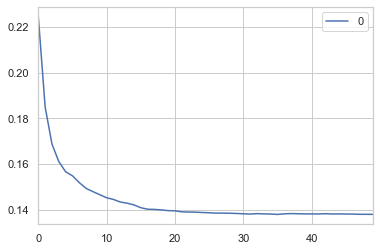

In [198]:
#plotting the rmse values against k values
curve = pd.DataFrame(rmse_val) #elbow curve 
curve.plot()

In [199]:
#check accuracy of our model on the test data
model.score(X_test, y_test)

-0.021129996761665604